# Final Project: 2020 US Elections

0. Imports 


1. Twitter Scrapping
    
    1.1. Pre-settings
    
    1.2. Collect tweets and filter by topic (keywords) and by language (english)
    
    1.3. Analysis of the dataset
    

2. Search engine
    
    2.1. Pre-processing the Tweets
    
    2.2. WordCloud
    
    2.3. Bar plot
    
    2.4. Inverted index 
    
    2.5. Query the index
    
    2.6. Ranking score (2.4.1. TF-IDF + cosine similarity & 2.4.2. MyScore + cosine similarity)

## 0. Imports 

In [1]:
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import csv
from collections import Counter
from wordcloud import WordCloud, ImageColorGenerator
import re
from nltk.corpus import stopwords
import datetime
from tweepy.streaming import StreamListener
from tweepy import OAuthHandler
from tweepy import Stream
from tweepy import API
from tweepy import Cursor
import time
from collections import defaultdict
from array import array
from nltk.stem import PorterStemmer
import math
import collections
from numpy import linalg as la
from itertools import islice

## 1. Twitter Scrapping

### 1.1. Pre-settings

In [2]:
## Access token  
### Not present for privacy reasons

In [3]:
auth = OAuthHandler(consumer_key1, consumer_secret1)
auth.set_access_token(access_token1, access_token_secret1)
api = API(auth_handler=auth, wait_on_rate_limit=True, wait_on_rate_limit_notify=True)

###  1.2. Collect tweets and filter by topic (keywords) and by language (english)

In [4]:
class MyStreamListener(StreamListener):
    """
    Twitter listener, collects streaming tweets and output to a file
    """
    def __init__(self, api, OUTPUT_FILENAME, stop_condition=10):
        """
        initialize the stream, with num. of tweets and saving the outputfile
        """
        
        # this line is needed to import the characteristics of the streaming API
        super(MyStreamListener, self).__init__()
        
        # to-count the number of tweets collected        
        self.num_tweets = 0
        
        # save filename
        self.filename = OUTPUT_FILENAME
        
        # stop-condition: stop after donwloading a certain number of tweets
        self.stop_condition = stop_condition 
        

    def on_status(self, status):     
        """
        this function runs each time a new bunch of tweets is retrived from the streaming
        """
        
        with open(self.filename, "a+") as f: #Appending data to a file
            tweet = status._json
            
            f.write(json.dumps(tweet) + '\n')
            #self.output.append(tweet)
            self.num_tweets += 1
        
            # Stop condition        
            if self.num_tweets <= self.stop_condition:
                return True
            else:
                return False
        

    def on_error(self, status):
        """
        function useful to handle errors. It's possible to personalize it 
        depending on the way we want to handle errors
        """
        
        print(status)
        #returning False in on_error disconnects the stream
        return False

In [5]:
%%time

OUTPUT_FILENAME = "data/final_project.json"
stop_condition = 100000

l = MyStreamListener(api, OUTPUT_FILENAME, stop_condition)
# here we recall the Stream Class from Tweepy to input the authentication info and our personalized listener 
stream = Stream(auth=api.auth, listener=l)

TRACKING_KEYWORDS = ["Biden", "Trump", "#USAElections2020", "#ElectionResults2020", "#Biden", "#DonaldTrump"]

stream.filter(
    track=TRACKING_KEYWORDS, 
    is_async=False, 
    languages = ["en"]
)

Wall time: 45min 46s


### 1.3. Analysis of the dataset

In [3]:
with open("data/final_project.json", "rb") as f:
    data = f.readlines()
    data = [json.loads(str_) for str_ in data]

In [4]:
df_tweets = pd.DataFrame.from_records(data)

In [5]:
print("The number of collected tweets is: {}".format(len(df_tweets)))

The number of collected tweets is: 311927


In [6]:
print("The number of columns for each tweet is: {} " .format(df_tweets.shape[1]))

The number of columns for each tweet is: 37 


In [7]:
print("The different fields of each tweet are: \n\n{}" .format(df_tweets.dtypes))

The different fields of each tweet are: 

created_at                    object
id                             int64
id_str                        object
text                          object
source                        object
truncated                       bool
in_reply_to_status_id        float64
in_reply_to_status_id_str     object
in_reply_to_user_id          float64
in_reply_to_user_id_str       object
in_reply_to_screen_name       object
user                          object
geo                           object
coordinates                   object
place                         object
contributors                  object
retweeted_status              object
is_quote_status                 bool
quote_count                    int64
reply_count                    int64
retweet_count                  int64
favorite_count                 int64
entities                      object
favorited                       bool
retweeted                       bool
filter_level                  obj

In [8]:
user_info = df_tweets["user"]
user_ids = []
ids_count = 0
for i in range(len(df_tweets)):
    id_user = user_info[i]["id"]
    if id_user in user_ids:
        pass
    else:
        user_ids.append(id_user)
        ids_count += 1
        
print("The number of unique users in the corpus is: {} " .format(ids_count))    

The number of unique users in the corpus is: 147659 


## 2. Search engine 

In [2]:
with open("data/final_project.json", "rb") as f:
#with open("data/final_project_fewToTest.json", "rb") as f:
    data = f.readlines()
    data = [json.loads(str_) for str_ in data]

In [3]:
df_tweets = pd.DataFrame.from_records(data)

In [4]:
print("The total number of tweets is: {}" .format(len(df_tweets)))

The total number of tweets is: 311927


In [5]:
df_tweets.head()

,created_at,id,id_str,text,source,truncated,in_reply_to_status_id,in_reply_to_status_id_str,in_reply_to_user_id,in_reply_to_user_id_str,...,timestamp_ms,quoted_status_id,quoted_status_id_str,quoted_status,quoted_status_permalink,display_text_range,extended_tweet,possibly_sensitive,extended_entities,withheld_in_countries
0,Sun Nov 22 09:01:08 +0000 2020,1330436137874288643,1330436137874288643,RT @Amy_Siskind: Biden has surpassed a 6 milli...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,None,NaN,None,...,1606035668234,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Sun Nov 22 09:01:08 +0000 2020,1330436137945448449,1330436137945448449,RT @AdamParkhomenko: CNN has a guest on report...,"<a href=""http://twitter.com/#!/download/ipad"" ...",False,NaN,None,NaN,None,...,1606035668251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Sun Nov 22 09:01:08 +0000 2020,1330436137899405315,1330436137899405315,RT @tara_atrandom: Breaking curfew? \n\nSurely...,"<a href=""http://twitter.com/#!/download/ipad"" ...",False,NaN,None,NaN,None,...,1606035668240,1.330395e+18,1330395436050501633,{'created_at': 'Sun Nov 22 06:19:24 +0000 2020...,"{'url': 'https://t.co/9ujJ5a0TFR', 'expanded':...",NaN,NaN,NaN,NaN,NaN
3,Sun Nov 22 09:01:08 +0000 2020,1330436137916264450,1330436137916264450,RT @realDonaldTrump: “President Trump has done...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,None,NaN,None,...,1606035668244,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Sun Nov 22 09:01:08 +0000 2020,1330436138302119936,1330436138302119936,RT @realTrumpForce: Trump loves America so muc...,"<a href=""http://twitter.com/download/iphone"" r...",False,NaN,None,NaN,None,...,1606035668336,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 2.1. Pre-processing the Tweets

In [6]:
'''
Description: Remove from the dataset all the tweets that are a duplicate of a tweet that we already have

Argument: dataset of all tweets

Return: dataset of unique tweets

'''
def uniqueTweets(tweets_collection):       
   
    positions_to_drop = []
    
    # Get all the tweets that are NOT a retweet
    original_tweets = []
    for pos, tweet in df_tweets.iterrows():
        if "RT" not in tweet["text"]:
            original_tweets.append(tweet["text"])
    
    # Get retweets of tweets that do not appear in the original_tweets 
    ## tweets from which we don't have the original one, only a retweet
    original_retweets = []
    for pos, tweet in df_tweets.iterrows():
        if "RT" in tweet["text"]:
            # Remove the "RT" and the mention (first chunk ended with :)
            tweet = tweet["text"].split(':')
            tweet.pop(0)
            tweet = ''.join(tweet)
            tweet = tweet.lstrip()
            if tweet not in original_retweets:
                if tweet not in original_retweets:
                    original_retweets.append(tweet)
            else:
                positions_to_drop.append(pos)

    unique_tweets = original_tweets + original_retweets
                        
    return unique_tweets, positions_to_drop

In [7]:
unique_tweets, positions_to_drop = uniqueTweets(df_tweets)
print("The total number of unique tweets is: {}" .format(len(unique_tweets)))
print("The total number of tweets to drop is: {}" .format(len(positions_to_drop)))

The total number of unique tweets is: 130912
The total number of tweets to drop is: 181015


In [8]:
df_tweets = df_tweets.drop(positions_to_drop)
print("Updated total number of tweets is: {}" .format(len(df_tweets)))

Updated total number of tweets is: 130912


In [9]:
df_tweets.head()

,created_at,id,id_str,text,source,truncated,in_reply_to_status_id,in_reply_to_status_id_str,in_reply_to_user_id,in_reply_to_user_id_str,...,timestamp_ms,quoted_status_id,quoted_status_id_str,quoted_status,quoted_status_permalink,display_text_range,extended_tweet,possibly_sensitive,extended_entities,withheld_in_countries
0,Sun Nov 22 09:01:08 +0000 2020,1330436137874288643,1330436137874288643,RT @Amy_Siskind: Biden has surpassed a 6 milli...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,None,NaN,None,...,1606035668234,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Sun Nov 22 09:01:08 +0000 2020,1330436137945448449,1330436137945448449,RT @AdamParkhomenko: CNN has a guest on report...,"<a href=""http://twitter.com/#!/download/ipad"" ...",False,NaN,None,NaN,None,...,1606035668251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Sun Nov 22 09:01:08 +0000 2020,1330436137899405315,1330436137899405315,RT @tara_atrandom: Breaking curfew? \n\nSurely...,"<a href=""http://twitter.com/#!/download/ipad"" ...",False,NaN,None,NaN,None,...,1606035668240,1.330395e+18,1330395436050501633,{'created_at': 'Sun Nov 22 06:19:24 +0000 2020...,"{'url': 'https://t.co/9ujJ5a0TFR', 'expanded':...",NaN,NaN,NaN,NaN,NaN
3,Sun Nov 22 09:01:08 +0000 2020,1330436137916264450,1330436137916264450,RT @realDonaldTrump: “President Trump has done...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,None,NaN,None,...,1606035668244,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Sun Nov 22 09:01:08 +0000 2020,1330436138302119936,1330436138302119936,RT @realTrumpForce: Trump loves America so muc...,"<a href=""http://twitter.com/download/iphone"" r...",False,NaN,None,NaN,None,...,1606035668336,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
'''
Description: Function to preprocess the tweets removing stopwords, punctiuation, emojis, RT word, 
stemming, transforming to lowercase, anonymizing the users and tokenizing.

Argument: tweet to be preprocessed - string

Return: preprocessed tweet - list of tokens

'''
def getTerms(tweet):       
    stemming = PorterStemmer()
    stops = set(stopwords.words("english"))
    
    #Remove punctuation
    tweet = re.sub('[.,:;!?"+-/()*..._“&]','',tweet).strip()
    
    #Remove some emojis
    tweet = re.sub('[\U00010000-\U0010ffff❤]','',tweet).strip()
    
    #Remove RT word
    tweet = re.sub('RT','',tweet).strip()

    #Remove amp html word 
    tweet = re.sub('&amp;','',tweet).strip()
    tweet = re.sub('amp','',tweet).strip()
    
    #Transform to lowercase
    tweet = tweet.lower()
       
    #Tokenize
    tweet = tweet.split()
    
    #Anonymize users (remove mentions)
    tweet = filter(lambda x:x[0]!='@', tweet)
    
    #Remove stopwords
    tweet = [word for word in tweet if word not in stops]
    
    #Stemming
    tweet = [stemming.stem(word) for word in tweet]   
    
    return tweet

In [10]:
# Test getTerms function
position = 1
aux = df_tweets["retweeted_status"][position]
if "extended_tweet" in aux:
    aux = aux["extended_tweet"]
    text = aux["full_text"]
else:
    text = df_tweets["text"][position]

print("The original tweet is:")
print(text)

print("\nThe preprocessed tweet is: ")
print(getTerms(text))

The original tweet is:
RT @AdamParkhomenko: CNN has a guest on reporting Trump has now lost 33 cases in court. That is false. He has lost 34.

The preprocessed tweet is: 
['cnn', 'guest', 'report', 'trump', 'lost', '33', 'case', 'court', 'fals', 'lost', '34']


### 2.2. Wordcloud

In [33]:
'''
Description: Create the bag of words that will be present in the inverted index

Argument: collection of tweets

Return: bag_of_words dictionary where the key is the word and the value the frequency of the word in the corpus

'''

def create_bag_of_words(tweets_collection):
    bag_of_words = {}
    
    # Get all the terms in the corpus
    for pos, tweet in tweets_collection.iterrows():
        #Get the preprocessed terms of the tweet text
        ## Get the full text if possible and the partial one if extended tweet (that contains the full text) is not present
        retweeted_status = tweets_collection["retweeted_status"][pos]
        if isinstance(retweeted_status,dict):
            if "extended_tweet" in retweeted_status:
                extended_tweet = retweeted_status["extended_tweet"]
                text = extended_tweet["full_text"]
            else:
                text = tweets_collection["text"][pos]
        else:
            text = tweets_collection["text"][pos]        
        
        lst_text = getTerms(text)

        # Create bag-of-words: dictionary where the key is the word and the value the frequency of the word in the corpus
        for word in lst_text:
            if word not in bag_of_words:
                bag_of_words[word] = 1
            else: 
                bag_of_words[word] += 1
        
    
    return bag_of_words

In [34]:
bag_of_words = create_bag_of_words(df_tweets)

In [35]:
def plot_wordcloud(title, dic_):
    fig, ax = plt.subplots(1, 1, figsize=(18,7))
    wordcloud = WordCloud(background_color="white",width=1600, height=800)
    wordcloud = wordcloud.generate_from_frequencies(dic_)
    ax.axis("off")     
    ax.imshow(wordcloud, interpolation='bilinear')

    ax.set_title(title)
    plt.tight_layout()
    fig.subplots_adjust(top=0.8)
    plt.show()

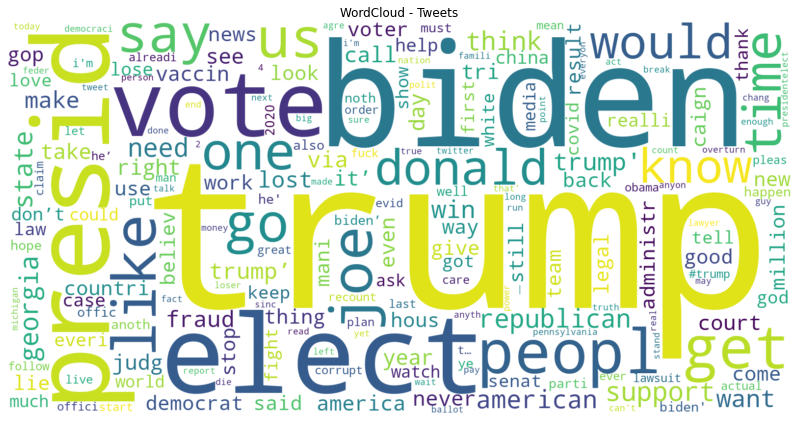

In [36]:
plot_wordcloud("WordCloud - Tweets", bag_of_words)

### 2.3. Bar plot

In [37]:
df_bag_of_words = pd.DataFrame(bag_of_words.items())
df_bag_of_words.columns = ["word", "count"]
df_bag_of_words.set_index("word", inplace=True)
df_bag_of_words.sort_values("count", inplace=True, ascending=False)

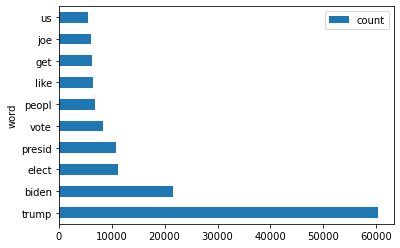

In [38]:
df_bag_of_words.head(10).plot.barh()
plt.show()

### 2.4. Inverted index

In [39]:
'''
Description: Implementation of the inverted index.

Argument: collection of tweets

Return: inverted index with terms as keys and the list of tweets where they appear (and the positions) as values

'''
def create_index(tweets_collection):
    
    index=defaultdict(list) 
    complete_tweet_count = 0
    partial_tweet_count = 0
    
    for pos, tweet in tweets_collection.iterrows():
        #Get the preprocessed terms of the tweet text
        ## Get the full text if possible and the partial one if extended tweet (that contains the full text) is not present
        retweeted_status = tweets_collection["retweeted_status"][pos]
        if isinstance(retweeted_status,dict):
            if "extended_tweet" in retweeted_status:
                extended_tweet = retweeted_status["extended_tweet"]
                text = extended_tweet["full_text"]
                complete_tweet_count += 1
            else:
                text = tweets_collection["text"][pos]
                partial_tweet_count += 1    
        else:
            text = tweets_collection["text"][pos]
            partial_tweet_count += 1
        
        
        terms = getTerms(text)  

        #Get the tweet id to identify the tweet - unique id for each tweet
        tweet_id = df_tweets["id"][pos]
        
        termdictPage={}
        for position, term in enumerate(terms): 
            try:
                # if term already in index for current page, append position to corresponding list
                termdictPage[term][1].append(position) 
            except:
                # Add the new term as dict key and initialize the array of positions and add the position
                termdictPage[term]=[tweet_id, array('I',[position])] #'I' indicates unsigned int (int in python)
            
        #merge the current page index with the main index
        for termpage, postingpage in termdictPage.items():
            index[termpage].append(postingpage)
    
    print("The number of tweets with full text is: {}" .format(complete_tweet_count))
    print("The number of tweets with partial text is: {}" .format(partial_tweet_count))
    
    return index

In [40]:
start_time = time.time()
index = create_index(df_tweets)
print("Total time to create the index: {} seconds" .format(np.round(time.time() - start_time,2)))

The number of tweets with full text is: 20633
The number of tweets with partial text is: 110279
Total time to create the index: 412.39 seconds


In [41]:
# Check the format of the inverted index
index

defaultdict(list,
            {'biden': [[1330436137874288643, array('I', [0])],
              [1330436139816267776, array('I', [6, 13])],
              [1330436141254725632, array('I', [3])],
              [1330436142991368195, array('I', [15, 20])],
              [1330436145436626946, array('I', [2])],
              [1330436147135188993, array('I', [9])],
              [1330436148125163521, array('I', [6])],
              [1330436149123411968, array('I', [5])],
              [1330436149945491458, array('I', [2])],
              [1330436151296057344, array('I', [3])],
              [1330436151530893317, array('I', [4, 16])],
              [1330436152126533634, array('I', [18])],
              [1330436152684376069, array('I', [13])],
              [1330436152982171650, array('I', [17])],
              [1330436153325993984, array('I', [8])],
              [1330436157939781639, array('I', [0])],
              [1330436158145273856, array('I', [9])],
              [1330436160334802944, arr

In [42]:
# Check the word trump
index["trump"]

[[1330436137945448449, array('I', [3])],
 [1330436137916264450, array('I', [1])],
 [1330436138302119936, array('I', [0, 14])],
 [1330436138746646529, array('I', [7])],
 [1330436138885111809, array('I', [2])],
 [1330436139396829186, array('I', [0])],
 [1330436140042633216, array('I', [6])],
 [1330436140378198017, array('I', [4])],
 [1330436140994863105, array('I', [9])],
 [1330436141254725632, array('I', [1])],
 [1330436141464641537, array('I', [9])],
 [1330436141632385026, array('I', [16])],
 [1330436141967953920, array('I', [2])],
 [1330436142357942275, array('I', [11])],
 [1330436142932615171, array('I', [0])],
 [1330436142991368195, array('I', [14])],
 [1330436142680903683, array('I', [3])],
 [1330436143419170816, array('I', [0])],
 [1330436144589402112, array('I', [7])],
 [1330436145474310145, array('I', [5])],
 [1330436146007044098, array('I', [6])],
 [1330436147168878593, array('I', [7])],
 [1330436147135188993, array('I', [8])],
 [1330436147701551104, array('I', [0])],
 [1330436

### 2.5. Query the index

In [43]:
'''
Description: Usage of inverted index with a query

Argument: the query entered by the user and the index previously generated

Return: list of tweets that contain all the query terms

'''
def search(query, index):
    
    query=getTerms(query)
    tweets=set()
    
    for term in query:
        try:
            # store in termTweets the ids of the tweets that contain "term"                        
            termTweets = [posting[0] for posting in index[term]]
            # Perform AND operation since we want tweets containing all the terms in the query 
            if len(tweets) == 0: #if the set is empty for the first iteration
                tweets |= set(termTweets)
            else:
                tweets &= set(termTweets)
        except:
            #term is not in index
            pass
    tweets=list(tweets)
    
    return tweets

In [56]:
print("Insert your query:\n")
query = input()
tweets = search(query, index)    
top = 10

print("\n======================\nSample of {} results out of {} for the seached query:\n".format(top, len(tweets)))
position = 0
for tweet in tweets[:top]:   
    user = {}
    entities = {}
    urls = []
    retweeted_status = {}
    
    print("\n---------------\n")
    #Get row index to extract the desired information
    position = df_tweets[df_tweets['id'] == tweet].index[0]
    
    date = df_tweets["created_at"][position]
    
    retweeted_status = df_tweets["retweeted_status"][position]
    if isinstance(retweeted_status,dict):
        if "extended_tweet" in retweeted_status:
            extended_tweet = retweeted_status["extended_tweet"]
            tweet_text = extended_tweet["full_text"]
            entities = extended_tweet["entities"]
            hashtags = entities["hashtags"] 
            if "media" in entities: 
                media = entities["media"]
                url = media[0]["expanded_url"]
            else:
                entitites = retweeted_status["entities"]
                urls = entities["urls"]
                if(urls != []):
                    url = urls[0]["expanded_url"]
                else:
                    url = []
        else:
            tweet_text = df_tweets["text"][position]
            entities = df_tweets["entities"][position]            
            hashtags = entities["hashtags"]
            urls = entities["urls"]
            if(urls != []):
                url = urls[0]["expanded_url"]
            else:
                url = []
        
        user = retweeted_status["user"]
        username = user["screen_name"]
        
        likes = retweeted_status["favorite_count"]
        retweets = retweeted_status["retweet_count"]        
            
    else:
        tweet_text = df_tweets["text"][position]
        user = df_tweets["user"][position]
        username = user["screen_name"]
        entities = df_tweets["entities"][position]
        hashtags = entities["hashtags"]
        likes = df_tweets["favorite_count"][position]
        retweets = df_tweets["retweet_count"][position]
        urls = entities["urls"]
        if(urls != []):
            url = urls[0]["expanded_url"]
        else:
            url = [] 

    # print all the desired information
    print("Tweet_id: {}".format(tweet))
    print("\n Tweet: {}".format(tweet_text))
    print("\n Username: {}".format(username))
    print("\n Date: {}".format(date))
    print("\n Hashtags: {}".format(hashtags))
    print("\n Likes: {}".format(likes))
    print("\n Retweets: {}".format(retweets))
    print("\n Url: {}".format(url))

Insert your query:

vote biden

Sample of 10 results out of 2460 for the seached query:


---------------

Tweet_id: 1330447738031407104

 Tweet: Just to show you a little red state, IN... Here they didn't take a single vote from Trump, but they stole all the third party votes and mostly gave them to Biden. https://t.co/Jc4JsMPpRk

 Username: redpillx2

 Date: Sun Nov 22 09:47:13 +0000 2020

 Hashtags: []

 Likes: 446

 Retweets: 168

 Url: https://twitter.com/redpillx2/status/1329240179878600705/photo/1

---------------

Tweet_id: 1330458386220023808

 Tweet: Republican Sen Pat Toomey congratulates Biden!  It's a start!  Biden has now beat tRump by over 6 Million votes (popular). It's about time for the rest of them to do the same!

 Username: AmyAThatcher

 Date: Sun Nov 22 10:29:32 +0000 2020

 Hashtags: []

 Likes: 483

 Retweets: 98

 Url: []

---------------

Tweet_id: 1330463840736215040

 Tweet: RT @PeepsLoving: Arrest this b*tch!

73 Percent of Biden Vote Margin Gain in PA in 

### 2.4. Ranking score


#### 2.4.1. TF-IDF + cosine similarity

In [11]:
'''
Description: Implementation of inverted index and computation of tf, df and idf

Argument: collection of tweets and the number of tweets

Return: inverted index, tf (normalized term frequency for each term in each document), 
df (number of documents each term appear in), idf (inverse document frequency of each term)

'''
def create_index_tfidf(tweets_collection, numTweets):
    
    index=defaultdict(list) 
    
    tf=defaultdict(list) # term frequencies of terms in tweets (tweets in the same order as in the main index)
    df=defaultdict(int) # tweet frequencies of terms in the corpus
    idf=defaultdict(float)
    
    
    for pos, tweet in tweets_collection.iterrows():
        #Get the preprocessed terms of the tweet text
        ## Get the full text if possible and the partial one if extended tweet (that contains the full text) is not present
        retweeted_status = tweets_collection["retweeted_status"][pos]
        if isinstance(retweeted_status,dict):
            if "extended_tweet" in retweeted_status:
                extended_tweet = retweeted_status["extended_tweet"]
                text = extended_tweet["full_text"]
            else:
                text = tweets_collection["text"][pos]
        else:
            text = tweets_collection["text"][pos]
        
        terms = getTerms(text)
        
        #Get the tweet id to identify the tweet
        tweet_id = df_tweets["id"][pos]
        
        
        #INVERTED INDEX
        #Construct the inverted index with the terms extracted and the ids of the tweets
        termdictPage={}
        for position, term in enumerate(terms): 
            try:
                # if term already in index for current tweet, append position to corresponding list
                termdictPage[term][1].append(position) 
            except:
                # Add the new term as dict key,  initialize the array of positions and add the position
                termdictPage[term]=[tweet_id, array('I',[position])] #'I' indicates unsigned int (int in python)
            
        # merge the current page index with the main index
        for termpage, postingpage in termdictPage.items():
            index[termpage].append(postingpage)
    
    
        #COMPUTE TF, DF AND IDF  
   
        # Compute the denominator to normalize term frequencies acording to the length of the tweet 
            ## Apply the Euclidean norm - same for all terms in a tweet
        norm=0
        for term, posting in termdictPage.items(): 
            norm+=len(posting[1])**2 # posting[1] is the frequency of term
        norm=math.sqrt(norm)        

        # Compute tf in the current tweet: number of times the term appears in the tweet (normalized)
        # Compute df: increase the term counter each time term appears in a tweet
        for term, posting in termdictPage.items():   
            tf[term].append(np.round(len(posting[1])/norm,4)) # append the term frequency in the tweet in the tf dictionary
            df[term]+=1  
                    
    # Compute idf 
    for term in df:
        idf[term] = np.round(np.log(float(numTweets/df[term])),4)
            
    return index, tf, df, idf

In [12]:
start_time = time.time()
numTweets = len(df_tweets)
index, tf, df, idf = create_index_tfidf(df_tweets, numTweets)
print("Total time to create the index: {} seconds" .format(np.round(time.time() - start_time,2)))

Total time to create the index: 340.01 seconds


In [13]:
idf

defaultdict(float,
            {'biden': 1.8491,
             'surpass': 7.9756,
             '6': 5.8742,
             'million': 4.1255,
             'popular': 5.8742,
             'vote': 2.9173,
             'victori': 5.1256,
             'margin': 6.4116,
             'approach': 7.2497,
             '80': 6.1368,
             'elector': 4.9375,
             'colleg': 5.8239,
             '306236': 11.7823,
             'especi': 6.2063,
             'incumb': 7.7749,
             'blowout': 9.8364,
             'decis': 5.8879,
             'close': 5.6532,
             'race': 5.9741,
             'american': 3.5595,
             'peopl': 3.0308,
             'need': 3.5343,
             'hear': 5.1027,
             'truth': 4.8606,
             'cnn': 5.9387,
             'guest': 8.0446,
             'report': 4.6831,
             'trump': 0.8398,
             'lost': 3.8147,
             '33': 8.4864,
             'case': 4.2912,
             'court': 3.9699,
             '

In [14]:
index

defaultdict(list,
            {'biden': [[1330436137874288643, array('I', [0])],
              [1330436139816267776, array('I', [6, 13])],
              [1330436141254725632, array('I', [3])],
              [1330436142991368195, array('I', [15, 20])],
              [1330436145436626946, array('I', [2])],
              [1330436147135188993, array('I', [9])],
              [1330436148125163521, array('I', [6])],
              [1330436149123411968, array('I', [5])],
              [1330436149945491458, array('I', [2])],
              [1330436151296057344, array('I', [3])],
              [1330436151530893317, array('I', [4, 16])],
              [1330436152126533634, array('I', [18])],
              [1330436152684376069, array('I', [13])],
              [1330436152982171650, array('I', [17])],
              [1330436153325993984, array('I', [8])],
              [1330436157939781639, array('I', [0])],
              [1330436158145273856, array('I', [9])],
              [1330436160334802944, arr

In [15]:
'''
Description: Ranking of the results based on the tf-idf weights and their cosine similarity.

Argument: list of the query terms, list of documents to rank matching the query, index, idf and tf

Return: List of ranked documents

'''
def rankDocuments(query_terms, tweets, index, idf, tf):
    
    # GENERATE THE QUERY AND TWEET VECTORS BASED ON TF-IDF SCORES

    # - Initialize the vectors 
    
    ## Initialize the query vector with 0s (as many as query terms in the query)
    queryVector=[0]*len(query_terms)   

    ## Initialize the tweet vector with a default dict that takes value [0]*len(query_terms) as default 
    ## for each non-existing key that we call. This is because we are only interested in the terms of the
    ## tweets vector that correspond to the query terms (other will became 0 when multiplied to queryVector)
    tweetVectors=defaultdict(lambda: [0]*len(query_terms))
        
    # - Compute the norm for the query terms frequency
    query_terms_count = collections.Counter(query_terms) # frequency of each term in query (key is the word and value its frequency)
    query_norm = la.norm(list(query_terms_count.values())) # norm for query
    
    # - Generate query and tweet vectors
    for termIndex, term in enumerate(query_terms): #termIndex is the index of the term in the query
        # if the term is not present in the index do not interact with that term but continue with the following ones
        if term not in index:
            continue
                    
        # Compute tf*idf for query vector (tf normalized as in tweets)
        queryVector[termIndex] = tf[term][termIndex]/query_norm * idf[term] 
        
        # Compute tf*idf for tweetsVectors 
        for tweetIndex, (tweet, postings) in enumerate(index[term]):        
            if tweet in tweets: # tweets parameter contains only tweets matching the query
                tweetVectors[tweet][termIndex] = tf[term][tweetIndex] * idf[term] 
                
    
    # COMPUTE COSINE SIMILARITY 
                    
    # Compute cosine similarity (dot product since for normalized vectors it corresponds to the cosine similarity)
    tweetScores=[ [np.dot(curTweetVec, queryVector), tweet] for tweet, curTweetVec in tweetVectors.items() ]
    
    
    # RANK DOCUMENTS BASED ON COSINE SIMILARITY
    
    #Sort the tweets in descending order based on the cosine similarity 
    tweetScores.sort(reverse=True) 
    resultTweets=[x[1] for x in tweetScores]
    
    if len(resultTweets) == 0:
        print("\nNo results found, try again\n")
        query = input()
        tweets = search_tf_idf(query, index)    

    return resultTweets

In [16]:
'''
Description: Usage of inverted index with a query also using the ranking of the tweets

Argument: the query entered by the user and the index previously generated

Return: list of tweets that contain all the query terms ranked by tf-idf 

'''
def search_tf_idf(query, index):

    query=getTerms(query)
    tweets=set()
    
    for term in query:
        try:
            # store in termDocs the ids of the docs that contain "term"                        
            termTweets=[posting[0] for posting in index[term]]
            # Perform AND operation since we want tweets containing all the terms in the query 
            if len(tweets) == 0: #if the set is empty for the first iteration
                tweets |= set(termTweets)
            else:
                tweets &= set(termTweets)
        except:
            #term is not in index
            pass
    tweets=list(tweets)
    ranked_tweets = rankDocuments(query, tweets, index, idf, tf)   
    return ranked_tweets

In [17]:
print("Insert your query:\n")
query = input()
ranked_tweets = search_tf_idf(query, index)    
top = 20

print("\n======================\nTop {} results out of {} for the seached query:\n".format(top, len(ranked_tweets)))
position = 0
for tweet in ranked_tweets[:top]:   
    user = {}
    entities = {}
    urls = []
    retweeted_status = {}
    
    print("\n---------------\n")
    #Get row index to extract the desired information
    position = df_tweets[df_tweets['id'] == tweet].index[0]
    
    date = df_tweets["created_at"][position]
    
    retweeted_status = df_tweets["retweeted_status"][position]
    if isinstance(retweeted_status,dict):
        if "extended_tweet" in retweeted_status:
            extended_tweet = retweeted_status["extended_tweet"]
            tweet_text = extended_tweet["full_text"]
            entities = extended_tweet["entities"]
            hashtags = entities["hashtags"] 
            if "media" in entities: 
                media = entities["media"]
                url = media[0]["expanded_url"]
            else:
                entitites = retweeted_status["entities"]
                urls = entities["urls"]
                if(urls != []):
                    url = urls[0]["expanded_url"]
                else:
                    url = []
        else:
            tweet_text = df_tweets["text"][position]
            entities = df_tweets["entities"][position]            
            hashtags = entities["hashtags"]
            urls = entities["urls"]
            if(urls != []):
                url = urls[0]["expanded_url"]
            else:
                url = []
        
        user = retweeted_status["user"]
        username = user["screen_name"]
        
        likes = retweeted_status["favorite_count"]
        retweets = retweeted_status["retweet_count"]        
            
    else:
        tweet_text = df_tweets["text"][position]
        user = df_tweets["user"][position]
        username = user["screen_name"]
        entities = df_tweets["entities"][position]
        hashtags = entities["hashtags"]
        likes = df_tweets["favorite_count"][position]
        retweets = df_tweets["retweet_count"][position]
        urls = entities["urls"]
        if(urls != []):
            url = urls[0]["expanded_url"]
        else:
            url = [] 

    # print all the desired information
    print("Tweet_id: {}".format(tweet))
    print("\n Tweet: {}".format(tweet_text))
    print("\n Username: {}".format(username))
    print("\n Date: {}".format(date))
    print("\n Hashtags: {}".format(hashtags))
    print("\n Likes: {}".format(likes))
    print("\n Retweets: {}".format(retweets))
    print("\n Url: {}".format(url))

Insert your query:

biden wins

Top 20 results out of 1243 for the seached query:


---------------

Tweet_id: 1336041388018987014

 Tweet: @thehill Not win Biden did not win

 Username: MSREDMAMA1

 Date: Mon Dec 07 20:14:24 +0000 2020

 Hashtags: []

 Likes: 0

 Retweets: 0

 Url: []

---------------

Tweet_id: 1336041749060390925

 Tweet: RT @VET_TYHALL: @GeoffRBennett @DemocratsUp @PeteWilliamsNBC Joe Biden wins again!
WINNING 🇺🇸

 Username: VET_TYHALL

 Date: Mon Dec 07 20:15:50 +0000 2020

 Hashtags: []

 Likes: 20

 Retweets: 2

 Url: []

---------------

Tweet_id: 1336305260911087616

 Tweet: Biden has won again. All the winning!

 Username: nbencesolutions

 Date: Tue Dec 08 13:42:56 +0000 2020

 Hashtags: []

 Likes: 0

 Retweets: 0

 Url: []

---------------

Tweet_id: 1336299955926032385

 Tweet: And Biden wins again! 😀😀😀

 Username: eileengo1

 Date: Tue Dec 08 13:21:51 +0000 2020

 Hashtags: []

 Likes: 0

 Retweets: 0

 Url: []

---------------

Tweet_id: 133629887575413

#### 2.4.2. MyScore + cosine similarity

In [18]:
'''
Description: Compute a score based on the popularity of a tweet, based on the number of likes and the number of retweets

Argument: collection of tweets and the number of tweets

Return: popularity dictionary

'''
def create_myscore(tweets_collection):
       
    num_likes= defaultdict(int) #number of likes that has the tweet
    num_retweets= defaultdict(int) #number of retweets that has the tweet
    popularity = defaultdict(int) 
    
    for pos, tweet in tweets_collection.iterrows():

        #Get the tweet id to identify the tweet
        tweet_id = tweets_collection["id"][pos]
        
        #COMPUTE SCORE BASED ON POPULATITY  
   
        # Compute number of likes and number of retweets for the tweet
        retweeted_status = tweets_collection["retweeted_status"][pos]
        if isinstance(retweeted_status,dict):
            likes = retweeted_status["favorite_count"]
            likes = int(likes)
            retweets = retweeted_status["retweet_count"]
            retweets = int(retweets)
        else:
            likes = 0
            retweets = 0
            
        #Compute popularity
        popularity[tweet_id] = likes + retweets
        
    return popularity

In [19]:
start_time = time.time()
popularity = create_myscore(df_tweets)
print("Total time to create the index: {} seconds" .format(np.round(time.time() - start_time,2)))

Total time to create the index: 16.57 seconds


In [20]:
print(dict(islice(popularity.items(), 10)))

{1330436137874288643: 13583, 1330436137945448449: 4144, 1330436137899405315: 38, 1330436137916264450: 272303, 1330436138302119936: 3439, 1330436138406854658: 0, 1330436138746646529: 0, 1330436138885111809: 22549, 1330436139396829186: 281, 1330436139904327680: 1523}


In [21]:
'''
Description: Ranking of the results based on the tf-idf weights and their cosine similarity.

Argument: list of the query terms, list of documents to rank matching the query, index, idf and tf

Return: List of ranked documents

'''
def rankDocuments_myscore(query_terms, tweets, index, idf, tf, popularity):
    
    # GENERATE THE QUERY AND TWEET VECTORS 

    # - Initialize the vectors 
    
    ## Initialize the query vector with 0s (as many as query terms in the query)
    queryVector=[0]*len(query_terms)   

    ## Initialize the tweet vector with a default dict that takes value [0]*len(query_terms) as default 
    ## for each non-existing key that we call. This is because we are only interested in the terms of the
    ## tweets vector that correspond to the query terms (other will became 0 when multiplied to queryVector)
    tweetVectors=defaultdict(lambda: [0]*len(query_terms))
        
    # - Compute the norm for the query terms frequency
    query_terms_count = collections.Counter(query_terms) # frequency of each term in query (key is the word and value its frequency)
    query_norm = la.norm(list(query_terms_count.values())) # norm for query
    
    # - Generate query and tweet vectors
    for termIndex, term in enumerate(query_terms): #termIndex is the index of the term in the query
        # if the term is not present in the index do not interact with that term but continue with the following ones
        if term not in index:
            continue
                    
        # Compute tf*idf for query vector (tf normalized as in tweets)
        queryVector[termIndex] = tf[term][termIndex]/query_norm * idf[term] 
        
        # Compute tf*idf for tweetsVectors 
        for tweetIndex, (tweet, postings) in enumerate(index[term]):        
            if tweet in tweets: # tweets parameter contains only tweets matching the query
                tweetVectors[tweet][termIndex] = tf[term][tweetIndex] * idf[term] 
     
   
    # GET POPULARITY SCORE AND SCALE BETWEEN 0 AND 1
    
    # Get score only from matching tweets
    popularity_score = defaultdict(int) 
    for tweet in tweets:
        popularity_score[tweet] = popularity[tweet]

    # Normalize between 0 and 1
        
    key_max = max(popularity_score.keys(), key=(lambda k: popularity_score[k]))
    key_min = min(popularity_score.keys(), key=(lambda k: popularity_score[k]))
    
    max_value = popularity_score[key_max]
    min_value = popularity_score[key_min]
    
    norm_popularity_score = defaultdict(int) 
    for tweet in popularity_score:
        value = popularity_score[tweet]
        normalized_value = (value-min_value)/(max_value-min_value)
        norm_popularity_score[tweet] = normalized_value 
    
    
    # COMPUTE COSINE SIMILARITY 
                    
    # Compute cosine similarity (dot product since for normalized vectors it corresponds to the cosine similarity)
    tweetScores=[ [np.dot(curTweetVec, queryVector), tweet] for tweet, curTweetVec in tweetVectors.items() ]
        
    # RANK DOCUMENTS BASED ON COSINE SIMILARITY AND POPULARITY    
    ## Compute the net score by a weighted sum of the cosine similarity and the popularity score   
    tfidf_pop_scores = defaultdict(int) 
    weight = 0.8
    for tweet in tweetScores:
        tfidf_score = tweet[0]
        popularity_score = norm_popularity_score[tweet[1]]
        net_score = (1 - weight)*tfidf_score + weight*popularity_score
        tfidf_pop_scores[tweet[1]] = net_score
    
    ## Sort the tweets in descending order based on the new score
    tfidf_pop_ranking = dict(sorted(tfidf_pop_scores.items(), key=lambda item: item[1], reverse=True))
    resultTweets= list(tfidf_pop_ranking.keys())        
        
    if len(resultTweets) == 0:
        print("\nNo results found, try again\n")
        query = input()
        tweets = search_tf_idf(query, index)    

    return resultTweets

In [22]:
'''
Description: Usage of inverted index with a query also using the ranking of the tweets

Argument: the query entered by the user and the index previously generated

Return: list of tweets that contain all the query terms ranked by tf-idf 

'''
def search_tf_idf(query, index):

    query=getTerms(query)
    tweets=set()
    
    for term in query:
        try:
            # store in termDocs the ids of the docs that contain "term"                        
            termTweets=[posting[0] for posting in index[term]]
            # Perform AND operation since we want tweets containing all the terms in the query 
            if len(tweets) == 0: #if the set is empty for the first iteration
                tweets |= set(termTweets)
            else:
                tweets &= set(termTweets)
        except:
            #term is not in index
            pass
    tweets=list(tweets)
    ranked_tweets = rankDocuments_myscore(query, tweets, index, idf, tf, popularity)   
    return ranked_tweets

In [23]:
print("Insert your query:\n")
query = input()
ranked_tweets = search_tf_idf(query, index)    
top = 20

print("\n======================\nTop {} results out of {} for the seached query:\n".format(top, len(ranked_tweets)))
for tweet in ranked_tweets[:top]:   
    position = 0
    user = {}
    entities = {}
    urls = []
    retweeted_status = {}
    
    print("\n---------------\n")
    #Get row index to extract the desired information
    position = df_tweets[df_tweets['id'] == tweet].index[0]
    
    date = df_tweets["created_at"][position]
    
    retweeted_status = df_tweets["retweeted_status"][position]
    if isinstance(retweeted_status,dict):
        if "extended_tweet" in retweeted_status:
            extended_tweet = retweeted_status["extended_tweet"]
            tweet_text = extended_tweet["full_text"]
            entities = extended_tweet["entities"]
            hashtags = entities["hashtags"] 
            if "media" in entities: 
                media = entities["media"]
                url = media[0]["expanded_url"]
            else:
                entitites = retweeted_status["entities"]
                urls = entities["urls"]
                if(urls != []):
                    url = urls[0]["expanded_url"]
                else:
                    url = []
        else:
            tweet_text = df_tweets["text"][position]
        
        user = retweeted_status["user"]
        username = user["screen_name"]
        
        likes = retweeted_status["favorite_count"]
        retweets = retweeted_status["retweet_count"]        
            
    else:
        tweet_text = df_tweets["text"][position]
        user = df_tweets["user"][position]
        username = user["screen_name"]
        entities = df_tweets["entities"][position]
        hashtags = entities["hashtags"]
        likes = df_tweets["favorite_count"][position]
        retweets = df_tweets["retweet_count"][position]
        urls = entities["urls"]
        if(urls != []):
            url = urls[0]["expanded_url"]
        else:
            url = [] 

    # print all the desired information
    print("Tweet_id: {}".format(tweet))
    print("\n Tweet: {}".format(tweet_text))
    print("\n Username: {}".format(username))
    print("\n Date: {}".format(date))
    print("\n Hashtags: {}".format(hashtags))
    print("\n Likes: {}".format(likes))
    print("\n Retweets: {}".format(retweets))
    print("\n Url: {}".format(url))


Insert your query:

biden wins

Top 20 results out of 1243 for the seached query:


---------------

Tweet_id: 1336043464232988675

 Tweet: Biden did poorly in big cities (Politico), except those of Detroit (more votes than people!), Philadelphia, Atlanta and Milwaukee, which he had to win. Not surprisingly, they are all located in the most important swing states, and are long known for being politically corrupt!

 Username: realDonaldTrump

 Date: Mon Dec 07 20:22:39 +0000 2020

 Hashtags: []

 Likes: 260873

 Retweets: 57440

 Url: []

---------------

Tweet_id: 1330436167704174593

 Tweet: Why is Joe Biden so quickly forming a Cabinet when my investigators have found hundreds of thousands of fraudulent votes, enough to “flip” at least four States, which in turn is more than enough to win the Election? Hopefully the Courts and/or Legislatures will have....

 Username: realDonaldTrump

 Date: Sun Nov 22 09:01:15 +0000 2020

 Hashtags: []

 Likes: 199868

 Retweets: 42567

 Url: []

--